<div style=" border-bottom: 8px solid #e3f56c; overflow: hidden; border-radius: 10px; height: 60px; width: 100%; display: flex;">
  <div style="height: 100%; width: 100%; background-color: #3800BB; float: left; text-align: center; display: flex; justify-content: left; align-items: center; font-size: 40px; ">
    <b><span style="color: #FFFFFF; padding: 20px 20px;">Automatic Feature Generation</span></b>
  </div>
</div>

<div class="alert" style="background-color: #FEDAD5; border-left: 8px solid #B12111; padding: 14px; border-radius: 8px; font-size: 14px; color: #000000;">
  <h5 style="font-size: 16px; margin-bottom: 10px;">
    <strong> Contents </strong>
  </h5>
<hr>
  <p><font size="3" face="Arial" font-size="large">
  <ul type="square">

  <li> Featuretools – for data in the form of a SQL database.  </li>
  <li> GeoPandas – for working with geospatial data.  </li>
  <li> Karateclub and NetworkX – for graphs.  </li>
  <li> Tsfresh – for time series.  </li>
  <li> Conclusions and summary.  </li>
  
  </ul>
  </font></p>

</div>

<div class="alert" style="background-color:  #E8F8F5; border-left: 8px solid #1ABC9C; padding: 14px; border-radius: 8px; font-size: 14px; color: #000000;">

* After extracting all meaningful visual dependencies from the raw data, and if no valuable insights have been obtained, the next logical step is to examine combinations of existing features — such as `products`, `sums`, `averages`, or `frequencies` of categorical variables.  
* Although this process may appear labor-intensive, it can be fully automated using specialized tools.
* This notebook focuses on libraries designed for automatic feature generation.

</div>

<div class="alert alert-warning">

### **FeatureTools**

</div>

<div class="alert" style="background-color:rgb(0, 0, 0); border-left: 8px solid #B12111; padding: 14px; border-radius: 8px; font-size: 14px; color:rgb(255, 255, 255);">

!pip install featuretools -q

</div>

<div class="alert" style="background-color:  #E8F8F5; border-left: 8px solid #1ABC9C; padding: 14px; border-radius: 8px; font-size: 14px; color: #000000;">

`Featuretools` is designed for data in the form of a SQL-style database — that is, multiple tables linked by ID fields.

</div>

<img src='../imgs/05.1.01_1.png' width='600px'>

In [1]:
import pandas as pd
import featuretools as ft
from classes import Paths

In [2]:
paths = Paths()

In [3]:
paths = Paths()

path_car_info = paths.car_train
path_rides_info = paths.rides_info
path_driver_info = paths.driver_info
path_fix_info = paths.fix_info

In [4]:
car_info = pd.read_csv(path_car_info)
rides_info = pd.read_csv(path_rides_info)
driver_info = pd.read_csv(path_driver_info)
fix_info = pd.read_csv(path_fix_info)

In [5]:
print('car_info', car_info.shape)
display(car_info.head(10))
print('rides_info', rides_info.shape)
display(rides_info.head(10))
print('driver_info', driver_info.shape)
display(driver_info.head(10))
print('fix_info', fix_info.shape)
display(fix_info.head(10))

car_info (2337, 10)


,car_id,model,car_type,fuel_type,car_rating,year_to_start,riders,year_to_work,target_reg,target_class
0,y13744087j,Kia Rio X-line,economy,petrol,3.78,2015,76163,2021,108.53,another_bug
1,O41613818T,VW Polo VI,economy,petrol,3.90,2015,78218,2021,35.20,electro_bug
2,d-2109686j,Renault Sandero,standart,petrol,6.30,2012,23340,2017,38.62,gear_stick
3,u29695600e,Mercedes-Benz GLC,business,petrol,4.04,2011,1263,2020,30.34,engine_fuel
4,N-8915870N,Renault Sandero,standart,petrol,4.70,2012,26428,2017,30.45,engine_fuel
5,b12101843B,Skoda Rapid,economy,petrol,2.36,2013,42176,2018,50.93,engine_ignition
6,Q-9368117S,Nissan Qashqai,standart,petrol,5.32,2012,24611,2014,54.79,engine_overheat
7,O-2124190y,Tesla Model 3,premium,electro,3.90,2017,116872,2019,50.26,gear_stick
8,h16895544p,Kia Sportage,standart,petrol,3.50,2014,56384,2017,33.24,gear_stick
9,K77009462l,Smart ForFour,economy,petrol,4.56,2013,41309,2018,39.43,gear_stick


rides_info (739500, 14)


,user_id,car_id,ride_id,ride_date,rating,ride_duration,ride_cost,speed_avg,speed_max,stop_times,distance,refueling,user_ride_quality,deviation_normal
0,o52317055h,A-1049127W,b1v,2020-01-01,4.95,21,268,36,113.548538,0,514.246920,0,1.115260,2.909
1,H41298704y,A-1049127W,T1U,2020-01-01,6.91,8,59,36,93.000000,1,197.520662,0,1.650465,4.133
2,v88009926E,A-1049127W,g1p,2020-01-02,6.01,20,315,61,81.959675,0,1276.328206,0,2.599112,2.461
3,t14229455i,A-1049127W,S1c,2020-01-02,0.26,19,205,32,128.000000,0,535.680831,0,3.216255,0.909
4,W17067612E,A-1049127W,X1b,2020-01-03,1.21,56,554,38,90.000000,1,1729.143367,0,2.716550,-1.822
5,I45176130J,A-1049127W,j1v,2020-01-03,7.52,67,1068,28,36.000000,2,363.209144,0,0.496265,-3.442
6,W11562554A,A-1049127W,A1g,2020-01-04,5.78,30,324,48,61.000000,0,1314.257355,0,1.464346,-6.004
7,o13713369s,A-1049127W,B1n,2020-01-04,7.35,29,401,57,65.845512,0,1753.888420,0,0.497193,-6.474
8,y62286141d,A-1049127W,h1a,2020-01-05,0.12,64,893,38,114.000000,1,2022.125012,0,-0.155147,-5.123
9,V28486769l,A-1049127W,p1e,2020-01-05,3.32,43,424,31,51.298365,1,1334.567248,0,-3.757628,-2.079


driver_info (15153, 7)


,age,user_rating,user_rides,user_time_accident,user_id,sex,first_ride_date
0,27,9.0,865,19.0,l17437965W,1,2019-4-2
1,46,7.9,2116,11.0,Z12362316j,0,2021-11-19
2,59,7.8,947,4.0,g11098715c,0,2021-1-15
3,37,7.0,18,4.0,U12618125q,0,2019-11-20
4,39,8.2,428,7.0,A14375829B,0,2019-7-23
5,21,9.9,831,22.0,L95976611S,1,2020-9-18
6,39,6.9,2293,5.0,z74338505G,0,2022-3-30
7,26,7.9,142,5.0,q11106749z,1,2019-12-22
8,18,9.3,425,18.0,r77865210A,1,2020-6-4
9,23,9.2,601,12.0,t10928335r,1,2020-7-18


fix_info (146000, 6)


,car_id,worker_id,fix_date,work_type,destroy_degree,work_duration
0,P17494612l,RJ,2020-6-20 2:14,reparking,8.0,49
1,N-1530212S,LM,2020-2-9 20:25,repair,10.0,48
2,B-1154399t,ND,2019-8-24 7:1,reparking,1.0,27
3,y13744087j,PG,2019-8-10 9:29,reparking,1.0,28
4,F12725233R,YC,2020-11-12 5:22,refuel_check,8.0,47
5,O41613818T,RW,2019-2-21 13:25,reparking,1.0,32
6,l-1139189J,PO,2020-3-2 19:11,reparking,1.0,28
7,d-2109686j,ML,2018-3-2 5:12,repair,7.4,39
8,u29695600e,QN,2020-2-2 20:10,reparking,10.0,64
9,U75286923j,KC,2019-9-2 6:32,reparking,1.0,24


<div class="alert" style="background-color:  #E8F8F5; border-left: 8px solid #1ABC9C; padding: 14px; border-radius: 8px; font-size: 14px; color: #000000;">

To begin, we need to create an `EntitySet`, which will contain our tables and the relationships between them.
</div>

In [6]:
es = ft.EntitySet(id="car_rides")
es

Entityset: car_rides
  DataFrames:
  Relationships:
    No relationships

<div class="alert" style="background-color:  #E8F8F5; border-left: 8px solid #1ABC9C; padding: 14px; border-radius: 8px; font-size: 14px; color: #000000;">

Next, we will add tables to the `EntitySet`.

Some columns in these tables — such as `model`, `fuel_type`, `car_type`, and `years_to_work` — are categorical. We typically do not want to apply operations like summation or averaging to them.  
Therefore, we will explicitly define data types for `Featuretools` using the `woodwork` library, which is installed along with `Featuretools`.

</div>

In [7]:
# let's see what types are presented
ft.list_logical_types()

,name,type_string,description,physical_type,standard_tags,is_default_type,is_registered,parent_type
0,Address,address,Represents Logical Types that contain address ...,string,{},True,True,None
1,Age,age,Represents Logical Types that contain whole nu...,int64,{numeric},True,True,Integer
2,AgeFractional,age_fractional,Represents Logical Types that contain non-nega...,float64,{numeric},True,True,Double
3,AgeNullable,age_nullable,Represents Logical Types that contain whole nu...,Int64,{numeric},True,True,IntegerNullable
4,Boolean,boolean,Represents Logical Types that contain binary v...,bool,{},True,True,BooleanNullable
5,BooleanNullable,boolean_nullable,Represents Logical Types that contain binary v...,boolean,{},True,True,None
6,Categorical,categorical,Represents Logical Types that contain unordere...,category,{category},True,True,None
7,CountryCode,country_code,Represents Logical Types that use the ISO-3166...,category,{category},True,True,Categorical
8,CurrencyCode,currency_code,Represents Logical Types that use the ISO-4217...,category,{category},True,True,Categorical
9,Datetime,datetime,Represents Logical Types that contain date and...,datetime64[ns],{},True,True,None


<div class="alert" style="background-color:  #E8F8F5; border-left: 8px solid #1ABC9C; padding: 14px; border-radius: 8px; font-size: 14px; color: #000000;">

We add our tables to the `entity_dataset` using the `add_dataframe` method, specifying data types for non-numeric columns.
</div>

In [8]:
from woodwork.logical_types import Categorical, Datetime, Age, Double

es = es.add_dataframe(
    dataframe_name="cars",
    dataframe=car_info,
    index="car_id",
    logical_types={"car_type": Categorical, 'fuel_type': Categorical, 'model': Categorical}
    )

es = es.add_dataframe(
    dataframe_name="rides",
    dataframe=rides_info.drop(['ride_id'], axis=1),
    index='index',
    time_index="ride_date",
    )

es = es.add_dataframe(
    dataframe_name="drivers",
    dataframe=driver_info,
    index="user_id",
    logical_types={"sex": Categorical, "first_ride_date": Datetime, "age": Age}
    )

es = es.add_dataframe(
    dataframe_name="fixes",
    dataframe=fix_info,
    index="index",
    logical_types={"work_type": Categorical, "worker_id":Categorical}
    )
es

/Users/lecha/dev/comp-ds/.venv3-11/lib/python3.11/site-packages/woodwork/type_sys/utils.py:33: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(
/Users/lecha/dev/comp-ds/.venv3-11/lib/python3.11/site-packages/woodwork/type_sys/utils.py:33: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(
/Users/lecha/dev/comp-ds/.venv3-11/lib/python3.11/site-packages/woodwork/type_sys/utils.py:33: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(
/Users/lecha/dev/comp-ds/.venv3-11/lib/python3.11/site-packages/woodwork/type_sys/utils.py:33: UserWarning: C

Entityset: car_rides
  DataFrames:
    cars [Rows: 2337, Columns: 10]
    rides [Rows: 739500, Columns: 14]
    drivers [Rows: 15153, Columns: 7]
    fixes [Rows: 146000, Columns: 7]
  Relationships:
    No relationships

<div class="alert" style="background-color: #FEF9E7; border-left: 8px solid #D4AC0D; padding: 14px; border-radius: 8px; font-size: 14px; color: #000000;">

Let's add relationships between dataframes
</div>

In [9]:
es = es.add_relationship("cars", "car_id", "rides", "car_id")
es = es.add_relationship("drivers", "user_id", "rides", "user_id")
es = es.add_relationship("cars", "car_id", "fixes", "car_id")

es

/Users/lecha/dev/comp-ds/.venv3-11/lib/python3.11/site-packages/featuretools/entityset/entityset.py:393: UserWarning: Logical type Categorical for child column car_id does not match parent column car_id logical type Unknown. Changing child logical type to match parent.
  warnings.warn(
/Users/lecha/dev/comp-ds/.venv3-11/lib/python3.11/site-packages/featuretools/entityset/entityset.py:393: UserWarning: Logical type Categorical for child column user_id does not match parent column user_id logical type Unknown. Changing child logical type to match parent.
  warnings.warn(


Entityset: car_rides
  DataFrames:
    cars [Rows: 2337, Columns: 10]
    rides [Rows: 739500, Columns: 14]
    drivers [Rows: 15153, Columns: 7]
    fixes [Rows: 146000, Columns: 7]
  Relationships:
    rides.car_id -> cars.car_id
    rides.user_id -> drivers.user_id
    fixes.car_id -> cars.car_id

<div class="alert" style="background-color: #FEF9E7; border-left: 8px solid #D4AC0D; padding: 14px; border-radius: 8px; font-size: 14px; color: #000000;">

Generate features for cars
</div>

In [10]:
feature_matrix, feature_defs = ft.dfs(
    entityset=es,
    target_dataframe_name="cars",
    max_depth=1,
)
feature_matrix.head()

/Users/lecha/dev/comp-ds/.venv3-11/lib/python3.11/site-packages/featuretools/computational_backends/feature_set_calculator.py:785: FutureWarning: The provided callable <function std at 0x111331440> is currently using SeriesGroupBy.std. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "std" instead.
  ).agg(to_agg)
/Users/lecha/dev/comp-ds/.venv3-11/lib/python3.11/site-packages/featuretools/computational_backends/feature_set_calculator.py:785: FutureWarning: The provided callable <function min at 0x111330a40> is currently using SeriesGroupBy.min. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "min" instead.
  ).agg(to_agg)
/Users/lecha/dev/comp-ds/.venv3-11/lib/python3.11/site-packages/featuretools/computational_backends/feature_set_calculator.py:785: FutureWarning: The provided callable <function sum at 0x111330220> is currently using SeriesGroupBy.s

,model,car_type,fuel_type,car_rating,year_to_start,riders,year_to_work,target_reg,target_class,COUNT(rides),...,MODE(fixes.work_type),MODE(fixes.worker_id),NUM_UNIQUE(fixes.work_type),NUM_UNIQUE(fixes.worker_id),SKEW(fixes.destroy_degree),SKEW(fixes.work_duration),STD(fixes.destroy_degree),STD(fixes.work_duration),SUM(fixes.destroy_degree),SUM(fixes.work_duration)
car_id,,,,,,,,,,,,,,,,,,,,,
y13744087j,Kia Rio X-line,economy,petrol,3.78,2015,76163,2021,108.53,another_bug,174,...,reparking,LR,4,33,0.835907,0.826462,2.732847,10.171884,106.7,933.0
O41613818T,VW Polo VI,economy,petrol,3.90,2015,78218,2021,35.20,electro_bug,174,...,reparking,YH,5,34,0.997276,-0.296841,2.707233,8.574733,102.1,873.0
d-2109686j,Renault Sandero,standart,petrol,6.30,2012,23340,2017,38.62,gear_stick,174,...,repair,AP,5,35,0.472628,0.671481,2.978077,13.040983,130.9,915.0
u29695600e,Mercedes-Benz GLC,business,petrol,4.04,2011,1263,2020,30.34,engine_fuel,174,...,repair,LM,4,34,0.492743,0.639490,3.237750,14.764994,143.0,1007.0
N-8915870N,Renault Sandero,standart,petrol,4.70,2012,26428,2017,30.45,engine_fuel,174,...,repair,CD,4,34,0.478043,1.341642,3.216758,12.659537,135.8,981.0


In [11]:
feature_matrix.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2337 entries, y13744087j to z-1337463D
Data columns (total 87 columns):
 #   Column                         Non-Null Count  Dtype   
---  ------                         --------------  -----   
 0   model                          2337 non-null   category
 1   car_type                       2337 non-null   category
 2   fuel_type                      2337 non-null   category
 3   car_rating                     2337 non-null   float64 
 4   year_to_start                  2337 non-null   int64   
 5   riders                         2337 non-null   int64   
 6   year_to_work                   2337 non-null   int64   
 7   target_reg                     2337 non-null   float64 
 8   target_class                   2337 non-null   category
 9   COUNT(rides)                   2337 non-null   Int64   
 10  MAX(rides.deviation_normal)    2337 non-null   float64 
 11  MAX(rides.distance)            2337 non-null   float64 
 12  MAX(rides.rating)       

<div class="alert" style="background-color:  #E8F8F5; border-left: 8px solid #1ABC9C; padding: 14px; border-radius: 8px; font-size: 14px; color: #000000;">

We can also generate only needed features
</div>

In [12]:
feature_matrix, feature_defs = ft.dfs(
    entityset=es,
    target_dataframe_name="cars",
    agg_primitives=["mode", "count"], # limit number of features
    max_depth=1, # limit depth
)
feature_matrix.head()

,model,car_type,fuel_type,car_rating,year_to_start,riders,year_to_work,target_reg,target_class,COUNT(rides),COUNT(fixes),MODE(fixes.work_type),MODE(fixes.worker_id)
car_id,,,,,,,,,,,,,
y13744087j,Kia Rio X-line,economy,petrol,3.78,2015,76163,2021,108.53,another_bug,174,35,reparking,LR
O41613818T,VW Polo VI,economy,petrol,3.90,2015,78218,2021,35.20,electro_bug,174,35,reparking,YH
d-2109686j,Renault Sandero,standart,petrol,6.30,2012,23340,2017,38.62,gear_stick,174,35,repair,AP
u29695600e,Mercedes-Benz GLC,business,petrol,4.04,2011,1263,2020,30.34,engine_fuel,174,35,repair,LM
N-8915870N,Renault Sandero,standart,petrol,4.70,2012,26428,2017,30.45,engine_fuel,174,35,repair,CD


<div class="alert" style="background-color:  #E8F8F5; border-left: 8px solid #1ABC9C; padding: 14px; border-radius: 8px; font-size: 14px; color: #000000;">

We can also control the complexity of generated features using the `max_depth` parameter. This allows features to be created not only within a single table but also by combining attributes from related tables.  

For debugging purposes, computations can be performed on a limited number of examples — instead of the entire dataset — by specifying a list of instance IDs using the `instance_ids` parameter.
</div>

In [13]:
feature_matrix, feature_defs = ft.dfs(
    entityset=es,
    target_dataframe_name="cars",
    agg_primitives=["mean", "sum", "mode"],
    instance_ids=["y13744087j", "d-2109686j", "N-8915870N"],
    max_depth=2,
)
feature_matrix.head()

/Users/lecha/dev/comp-ds/.venv3-11/lib/python3.11/site-packages/featuretools/computational_backends/feature_set_calculator.py:785: FutureWarning: The provided callable <function sum at 0x111330220> is currently using SeriesGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.
  ).agg(to_agg)
/Users/lecha/dev/comp-ds/.venv3-11/lib/python3.11/site-packages/featuretools/computational_backends/feature_set_calculator.py:785: FutureWarning: The provided callable <function mean at 0x111331300> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  ).agg(to_agg)
/Users/lecha/dev/comp-ds/.venv3-11/lib/python3.11/site-packages/featuretools/computational_backends/feature_set_calculator.py:785: FutureWarning: The provided callable <function sum at 0x111330220> is currently using SeriesGroupB

,model,car_type,fuel_type,car_rating,year_to_start,riders,year_to_work,target_reg,target_class,MEAN(rides.deviation_normal),...,MEAN(rides.drivers.user_time_accident),MODE(rides.DAY(ride_date)),MODE(rides.MONTH(ride_date)),MODE(rides.WEEKDAY(ride_date)),MODE(rides.YEAR(ride_date)),MODE(rides.drivers.sex),SUM(rides.drivers.age),SUM(rides.drivers.user_rating),SUM(rides.drivers.user_rides),SUM(rides.drivers.user_time_accident)
car_id,,,,,,,,,,,,,,,,,,,,,
y13744087j,Kia Rio X-line,economy,petrol,3.78,2015,76163,2021,108.53,another_bug,-0.120391,...,17.724138,1,1,2,2020,1,5831.0,1432.0,144078.0,2056.0
d-2109686j,Renault Sandero,standart,petrol,6.30,2012,23340,2017,38.62,gear_stick,-2.223954,...,9.775862,1,1,2,2020,1,5714.0,1364.7,163567.0,1701.0
N-8915870N,Renault Sandero,standart,petrol,4.70,2012,26428,2017,30.45,engine_fuel,12.455678,...,15.758333,1,1,2,2020,0,5968.0,1411.5,155944.0,1891.0


<div class="alert" style="background-color:  #E8F8F5; border-left: 8px solid #1ABC9C; padding: 14px; border-radius: 8px; font-size: 14px; color: #000000;">

All available types of features can be viewed in `list_primitives`.
</div>

In [14]:
ft.list_primitives().head()

,name,type,description,valid_inputs,return_type
0,count_below_mean,aggregation,Determines the number of values that are below...,<ColumnSchema (Semantic Tags = ['numeric'])>,<ColumnSchema (Logical Type = IntegerNullable)...
1,min,aggregation,"Calculates the smallest value, ignoring `NaN` ...",<ColumnSchema (Semantic Tags = ['numeric'])>,<ColumnSchema (Semantic Tags = ['numeric'])>
2,std,aggregation,Computes the dispersion relative to the mean v...,<ColumnSchema (Semantic Tags = ['numeric'])>,<ColumnSchema (Semantic Tags = ['numeric'])>
3,count_less_than,aggregation,Determines the number of values less than a co...,<ColumnSchema (Semantic Tags = ['numeric'])>,<ColumnSchema (Logical Type = Integer) (Semant...
4,n_unique_days,aggregation,Determines the number of unique days.,<ColumnSchema (Logical Type = Datetime)>,<ColumnSchema (Logical Type = Integer) (Semant...


<div class="alert" style="background-color:  #E8F8F5; border-left: 8px solid #1ABC9C; padding: 14px; border-radius: 8px; font-size: 14px; color: #000000;">

`Featuretools` includes a built-in feature selection mechanism that provides three main functions:

* `ft.selection.remove_highly_null_features()` – removes features with a high percentage of missing values  
* `ft.selection.remove_single_value_features()` – removes constant (single-value) features  
* `ft.selection.remove_highly_correlated_features()` – removes highly correlated features  

Each function takes a DataFrame as an argument and behaves according to its name.

The library also offers many other useful features — refer to the [official documentation](https://featuretools.alteryx.com/en/stable/index.html) for more details.

</div>

<div class="alert alert-warning">

### **GeoPandas**

</div>

<div class="alert" style="background-color:  #E8F8F5; border-left: 8px solid #1ABC9C; padding: 14px; border-radius: 8px; font-size: 14px; color: #000000;">


Geographic coordinates or location-based features are often present in datasets used in data analysis competitions.  
To work with such data, the `GeoPandas` library can be used. It combines the functionality of `Pandas` with `Shapely`, a library for geospatial computations.
</div>

<div class="alert" style="background-color: #FEF9E7; border-left: 8px solid #D4AC0D; padding: 14px; border-radius: 8px; font-size: 14px; color: #000000;">

Let's load `California Housing Dataset` - data for house pricing prediction
</div>

In [15]:
import geopandas as gpd
# from sklearn.datasets import fetch_california_housing

In [16]:
from classes import Paths
paths = Paths()
path_df = paths.cal_housing_data
path_df_domain = paths.cal_housing_domain

In [17]:
domain_lines = []
with open(path_df_domain, "rb") as f:
    for i in range(9):
        t = f.readline()
        domain_lines.append(t.decode("utf-8").strip())
domain_lines

cal_h_col_names = []
for i in domain_lines:
    cal_h_col_names.append(i.split(':')[0])
cal_h_col_names

['longitude',
 'latitude',
 'housingMedianAge',
 'totalRooms',
 'totalBedrooms',
 'population',
 'households',
 'medianIncome',
 'medianHouseValue']

In [18]:
df = pd.read_csv(path_df, names=cal_h_col_names)
print(df.shape)
df.head(10)

(20640, 9)


,longitude,latitude,housingMedianAge,totalRooms,totalBedrooms,population,households,medianIncome,medianHouseValue
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0
5,-122.25,37.85,52.0,919.0,213.0,413.0,193.0,4.0368,269700.0
6,-122.25,37.84,52.0,2535.0,489.0,1094.0,514.0,3.6591,299200.0
7,-122.25,37.84,52.0,3104.0,687.0,1157.0,647.0,3.1200,241400.0
8,-122.26,37.84,42.0,2555.0,665.0,1206.0,595.0,2.0804,226700.0
9,-122.25,37.84,52.0,3549.0,707.0,1551.0,714.0,3.6912,261100.0


<div class="alert" style="background-color: #FEF9E7; border-left: 8px solid #D4AC0D; padding: 14px; border-radius: 8px; font-size: 14px; color: #000000;">

We are interested in `longitude` and `latitude` columns

</div>

In [19]:
# let's create GeoDataFrame
gdf = gpd.GeoDataFrame(
        df,
        geometry=gpd.points_from_xy(df['longitude'], df['latitude']),
        crs=4326
    ).to_crs(epsg=3857)
gdf.head(3)

,longitude,latitude,housingMedianAge,totalRooms,totalBedrooms,population,households,medianIncome,medianHouseValue,geometry
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,POINT (-13606581.36 4562487.679)
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,POINT (-13605468.165 4559667.342)
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,POINT (-13607694.555 4558257.461)


<div class="alert" style="background-color:  #E8F8F5; border-left: 8px solid #1ABC9C; padding: 14px; border-radius: 8px; font-size: 14px; color: #000000;">

As you can see, it is not significantly different from a regular DataFrame. The only distinction is the `geometry` column, which is a `GeoSeries` object. This object provides additional attributes and methods specific to geospatial data.
</div>

In [20]:
type(gdf['geometry'])

geopandas.geoseries.GeoSeries

In [21]:
gpd.geoseries.GeoSeries?

Init signature:
gpd.geoseries.GeoSeries(
    data=None,
    index=None,
    crs: 'Optional[Any]' = None,
    **kwargs,
)
Docstring:     
A Series object designed to store shapely geometry objects.

Parameters
----------
data : array-like, dict, scalar value
    The geometries to store in the GeoSeries.
index : array-like or Index
    The index for the GeoSeries.
crs : value (optional)
    Coordinate Reference System of the geometry objects. Can be anything accepted by
    :meth:`pyproj.CRS.from_user_input() <pyproj.crs.CRS.from_user_input>`,
    such as an authority string (eg "EPSG:4326") or a WKT string.

kwargs
    Additional arguments passed to the Series constructor,
     e.g. ``name``.

Examples
--------

>>> from shapely.geometry import Point
>>> s = geopandas.GeoSeries([Point(1, 1), Point(2, 2), Point(3, 3)])
>>> s
0    POINT (1 1)
1    POINT (2 2)
2    POINT (3 3)
dtype: geometry

>>> s = geopandas.GeoSeries(
...     [Point(1, 1), Point(2, 2), Point(3, 3)], crs="EPSG:3857"
...

<div class="alert" style="background-color:  #E8F8F5; border-left: 8px solid #1ABC9C; padding: 14px; border-radius: 8px; font-size: 14px; color: #000000;">

Inside the `geometry` column are `Point` objects from the `shapely` library.
</div>

In [22]:
type(gdf['geometry'][0])

shapely.geometry.point.Point

In [23]:
import shapely
shapely.geometry.point.Point?

Init signature: shapely.geometry.point.Point(*args)
Docstring:     
A geometry type that represents a single coordinate.

Each coordinate has x, y and possibly z and/or m values.

A point is a zero-dimensional feature and has zero length and zero area.

Parameters
----------
args : float, or sequence of floats
    The coordinates can either be passed as a single parameter, or as
    individual float values using multiple parameters:

    1) 1 parameter: a sequence or array-like of with 2 or 3 values.
    2) 2 or 3 parameters (float): x, y, and possibly z.

Attributes
----------
x, y, z, m : float
    Coordinate values

Examples
--------
Constructing the Point using separate parameters for x and y:

>>> from shapely import Point
>>> p = Point(1.0, -1.0)

Constructing the Point using a list of x, y coordinates:

>>> p = Point([1.0, -1.0])
>>> print(p)
POINT (1 -1)
>>> p.y
-1.0
>>> p.x
1.0
File:           ~/dev/comp-ds/.venv3-11/lib/python3.11/site-packages/shapely/geometry/point.py
Type:

<div class="alert" style="background-color:  #E8F8F5; border-left: 8px solid #1ABC9C; padding: 14px; border-radius: 8px; font-size: 14px; color: #000000;">

It’s worth noting that GeoPandas supports not only points, but also linestrings, polygons, and mixed geometry types.

For more details, see: https://shapely.readthedocs.io/en/stable/manual.html

</div>


<div class="alert alert-warning">

### **County Feature**

</div>

<div class="alert" style="background-color:  #E8F8F5; border-left: 8px solid #1ABC9C; padding: 14px; border-radius: 8px; font-size: 14px; color: #000000;">

Now let’s move on to feature generation. California is a large state with 58 counties. Each county has its own standard of living, climate, and consequently, housing prices. A categorical feature indicating county membership could potentially be useful.

To begin, we need to obtain the geographic coordinates of the counties. We'll take them from the California Open Data portal: https://data.ca.gov

</div>

In [24]:
import requests, zipfile, io

In [25]:
county_fname = 'https://github.com/aziart/comp-ds/raw/refs/heads/main/data/ca-county-boundaries.zip'


r2 = requests.get(county_fname)
z2 = zipfile.ZipFile(io.BytesIO(r2.content))
z2.extractall("./ca")

In [26]:
ca_counties=gpd.read_file('./ca/CA_Counties').to_crs("EPSG:3857")
ca_counties.head(3)

,STATEFP,COUNTYFP,COUNTYNS,GEOID,NAME,NAMELSAD,LSAD,CLASSFP,MTFCC,CSAFP,CBSAFP,METDIVFP,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry
0,06,091,00277310,06091,Sierra,Sierra County,06,H1,G4020,None,None,None,A,2468694587,23299110,+39.5769252,-120.5219926,"POLYGON ((-13431319.751 4821511.426, -13431312..."
1,06,067,00277298,06067,Sacramento,Sacramento County,06,H1,G4020,472,40900,None,A,2499183617,76073827,+38.4500114,-121.3404409,"POLYGON ((-13490651.476 4680831.603, -13490511..."
2,06,083,00277306,06083,Santa Barbara,Santa Barbara County,06,H1,G4020,None,42200,None,A,7084000598,2729814515,+34.5370572,-120.0399729,"MULTIPOLYGON (((-13423116.772 4042044.149, -13..."


<div class="alert" style="background-color: #FEF9E7; border-left: 8px solid #D4AC0D; padding: 14px; border-radius: 8px; font-size: 14px; color: #000000;">

Now let's add features

</div>

In [27]:
gdf = gpd.overlay(gdf, ca_counties[['NAME', 'geometry']], how='intersection')

In [28]:
gdf.head(10)

,longitude,latitude,housingMedianAge,totalRooms,totalBedrooms,population,households,medianIncome,medianHouseValue,NAME,geometry
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,Alameda,POINT (-13606581.36 4562487.679)
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,Alameda,POINT (-13605468.165 4559667.342)
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,Alameda,POINT (-13607694.555 4558257.461)
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,Alameda,POINT (-13608807.749 4558257.461)
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,Alameda,POINT (-13608807.749 4558257.461)
5,-122.25,37.85,52.0,919.0,213.0,413.0,193.0,4.0368,269700.0,Alameda,POINT (-13608807.749 4558257.461)
6,-122.25,37.84,52.0,2535.0,489.0,1094.0,514.0,3.6591,299200.0,Alameda,POINT (-13608807.749 4556847.771)
7,-122.25,37.84,52.0,3104.0,687.0,1157.0,647.0,3.1200,241400.0,Alameda,POINT (-13608807.749 4556847.771)
8,-122.26,37.84,42.0,2555.0,665.0,1206.0,595.0,2.0804,226700.0,Alameda,POINT (-13609920.944 4556847.771)
9,-122.25,37.84,52.0,3549.0,707.0,1551.0,714.0,3.6912,261100.0,Alameda,POINT (-13608807.749 4556847.771)


<div class="alert" style="background-color: #FEF9E7; border-left: 8px solid #D4AC0D; padding: 14px; border-radius: 8px; font-size: 14px; color: #000000;">

`NAME` column is added.  
Now, with `Counter` for each county let's calculate how many houses are there

</div>

In [29]:
from collections import Counter

Counter(gdf['NAME']).most_common()

[('Los Angeles', 5824),
 ('Orange', 1618),
 ('San Diego', 1609),
 ('Alameda', 1017),
 ('Santa Clara', 1003),
 ('San Bernardino', 831),
 ('Sacramento', 688),
 ('Contra Costa', 597),
 ('Riverside', 588),
 ('San Francisco', 575),
 ('Fresno', 525),
 ('San Mateo', 447),
 ('San Joaquin', 419),
 ('Ventura', 384),
 ('Kern', 370),
 ('Sonoma', 313),
 ('Santa Barbara', 307),
 ('Stanislaus', 303),
 ('Tulare', 258),
 ('Monterey', 202),
 ('Solano', 199),
 ('Santa Cruz', 191),
 ('Marin', 166),
 ('Butte', 156),
 ('San Luis Obispo', 139),
 ('Placer', 132),
 ('Merced', 128),
 ('Humboldt', 127),
 ('Shasta', 121),
 ('El Dorado', 120),
 ('Imperial', 118),
 ('Napa', 103),
 ('Nevada', 96),
 ('Kings', 88),
 ('Lake', 87),
 ('Mendocino', 79),
 ('Yolo', 79),
 ('Madera', 75),
 ('Tuolumne', 57),
 ('Sutter', 56),
 ('Yuba', 53),
 ('Tehama', 49),
 ('Siskiyou', 37),
 ('Plumas', 33),
 ('Calaveras', 32),
 ('Amador', 28),
 ('San Benito', 28),
 ('Trinity', 27),
 ('Glenn', 26),
 ('Lassen', 25),
 ('Inyo', 18),
 ('Mariposa',

<div class="alert" style="background-color:  #E8F8F5; border-left: 8px solid #1ABC9C; padding: 14px; border-radius: 8px; font-size: 14px; color: #000000;">

It is often useful to visualize data on a map to ensure its validity — for example, confirming that houses are not located in the ocean or identifying potential outliers.  
Geographic features, such as proximity to the ocean or a body of water, can also be strong predictors of real estate prices.  
Objects can be plotted on a map using the `folium` library. While `geopandas` also provides mapping tools, `folium` offers a more convenient and interactive experience.

</div>

In [30]:
import folium

# Create a map object
m = folium.Map([37, -122], tiles='OpenStreetMap', zoom_start=6)

# Add points to the map using a simple apply
gdf.apply(lambda row: folium.CircleMarker(location=[row["latitude"], row["longitude"]],
                                          popup=row.name,
                                          radius=1).add_to(m), axis=1)

# Add Los Angeles (optional)
# folium.CircleMarker(location=[34.033333, -118.266667],
#                     radius=3, color='red').add_to(m)

m

<div class="alert alert-warning">

### **[Karateclub](https://karateclub.readthedocs.io/en/latest/index.html) and [Network X](https://networkx.org/)**

</div>

<div class="alert" style="background-color:  #E8F8F5; border-left: 8px solid #1ABC9C; padding: 14px; border-radius: 8px; font-size: 14px; color: #000000;">

Let's start with a simple example—where do graphs even come from in data analysis?

Imagine we have a credit scoring task.

There's John, and John has a bad credit history with many debts. Will we approve a loan for John? Most likely not.

But John also has a wife, Emily, who is also a client of our bank. She has a good credit history, has taken several large loans, and repaid everything without any debts.

We understand that they will likely repay the loan together, so we could consider raising John's score—but by how much? And what algorithm should we use for this?

In principle, we could use decision trees here. But what if we want to use information about other relatives? We won't have information about every family member for each person. Or maybe our task isn't credit scoring at all, but a recommendation system in a social network, and we want to show ads based on the interests of friends?

For such tasks, we need to work with graphs.

</div>

In [31]:
import numpy as np
import networkx as nx

<div class="alert" style="background-color:  #E8F8F5; border-left: 8px solid #1ABC9C; padding: 14px; border-radius: 8px; font-size: 14px; color: #000000;">


Let's first understand what a graph is.

A graph can be defined as G = (V, E), where V is a set of nodes and E is a list of edges.

Let's represent our John and Emily as a graph using `NetworkX`.
</div>

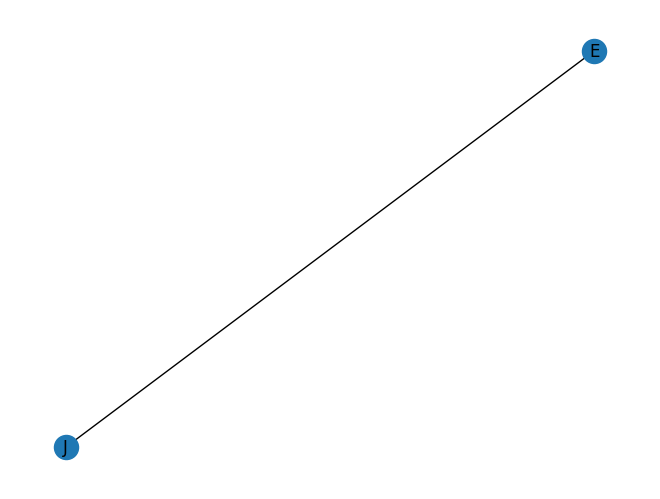

In [32]:
g = nx.Graph()
g.add_node('J')
g.add_node('E')
g.add_edge('J','E')
nx.draw(g, with_labels=True)

<div class="alert" style="background-color:  #E8F8F5; border-left: 8px solid #1ABC9C; padding: 14px; border-radius: 8px; font-size: 14px; color: #000000;">


Vertices are data points - our John and Emily - and the connection between them is defined by an edge.

In this example, we created an empty graph and then added the vertices and the edge between them one by one. However, in `NetworkX`, we can add multiple vertices or edges at once using the `add_nodes_from()` and `add_edges_from()` methods, which accept lists of elements.

Let's add two adult children to the family: Harry and Sarah.
</div>

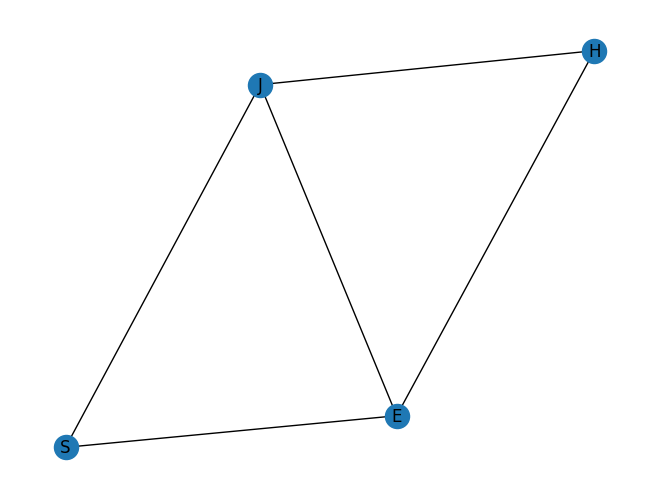

In [33]:
g.add_nodes_from(['H','S'])
g.add_edges_from([('H','J'),('H','E'),('S','J'),('S','E')])
nx.draw(g, with_labels=True)

<div class="alert" style="background-color:  #E8F8F5; border-left: 8px solid #1ABC9C; padding: 14px; border-radius: 8px; font-size: 14px; color: #000000;">


We have created the graph, but we still don't have any features. Let's add them.

Let's add the total amount of loans repaid and their count.

It's convenient to add attributes to nodes using the `set_node_attributes` function. It takes a dictionary of dictionaries as input, and a transposed DataFrame will work well for this.

</div>

In [34]:
feat = {'J':{'sum':2000000,'count':10},
        'E':{'sum':1000000,'count':4},
        'H':{'sum':40000,'count':1},
        'S':{'sum':0,'count':0},}

feat = pd.DataFrame(feat).T
feat

,sum,count
J,2000000,10
E,1000000,4
H,40000,1
S,0,0


In [35]:
nx.set_node_attributes(g, feat.T)

<div class="alert alert-warning">

### **More Advanced Features from `NetworkX`**
</div>

<img src='../imgs/05.1.01_2.png' width='800px'>

<div class="alert" style="background-color:  #E8F8F5; border-left: 8px solid #1ABC9C; padding: 14px; border-radius: 8px; font-size: 14px; color: #000000;">

**Centrality** — a measure of a node’s importance within a graph:  
* `nx.degree_centrality(G)` – importance based on the number of neighbors  
* `nx.betweenness_centrality(G)` – importance as an intermediary  
* `nx.closeness_centrality(G)` – importance based on proximity to all other nodes  

To demonstrate these features, we’ll use a dataset containing all relationships between characters from the Star Wars universe.

</div>

In [36]:
import json
import requests
from collections import Counter
from networkx.readwrite import json_graph

In [37]:
from classes import Paths
paths = Paths()
path = paths.json_sample

In [38]:
with open(path, "r") as f:
    interactions = json.load(f)

In [39]:
interactions['nodes'][:10]

[{'name': 'QUI-GON', 'value': 61, 'colour': '#4f4fb1'},
 {'name': 'NUTE GUNRAY', 'value': 24, 'colour': '#808080'},
 {'name': 'PK-4', 'value': 3, 'colour': '#808080'},
 {'name': 'TC-14', 'value': 4, 'colour': '#808080'},
 {'name': 'OBI-WAN', 'value': 147, 'colour': '#48D1CC'},
 {'name': 'DOFINE', 'value': 3, 'colour': '#808080'},
 {'name': 'RUNE', 'value': 10, 'colour': '#808080'},
 {'name': 'TEY HOW', 'value': 4, 'colour': '#808080'},
 {'name': 'EMPEROR', 'value': 51, 'colour': '#191970'},
 {'name': 'CAPTAIN PANAKA', 'value': 19, 'colour': '#808080'}]

In [40]:
interactions['links'][:10]

[{'source': 1, 'target': 0, 'value': 1},
 {'source': 2, 'target': 3, 'value': 1},
 {'source': 4, 'target': 3, 'value': 1},
 {'source': 0, 'target': 3, 'value': 1},
 {'source': 4, 'target': 0, 'value': 26},
 {'source': 1, 'target': 3, 'value': 1},
 {'source': 5, 'target': 1, 'value': 1},
 {'source': 5, 'target': 3, 'value': 1},
 {'source': 1, 'target': 6, 'value': 8},
 {'source': 6, 'target': 7, 'value': 2}]

In [41]:
interactions['directed'] = False
interactions['multigraph'] = False
interactions['graph'] = {}

/Users/lecha/dev/comp-ds/.venv3-11/lib/python3.11/site-packages/networkx/readwrite/json_graph/node_link.py:287: FutureWarning: 
The default value will be changed to `edges="edges" in NetworkX 3.6.

To make this warning go away, explicitly set the edges kwarg, e.g.:

  nx.node_link_graph(data, edges="links") to preserve current behavior, or
  nx.node_link_graph(data, edges="edges") for forward compatibility.
  warnings.warn(


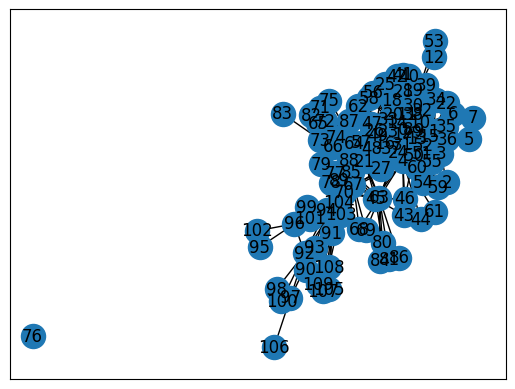

In [42]:
G = json_graph.node_link_graph(interactions)
nx.draw_networkx(G)

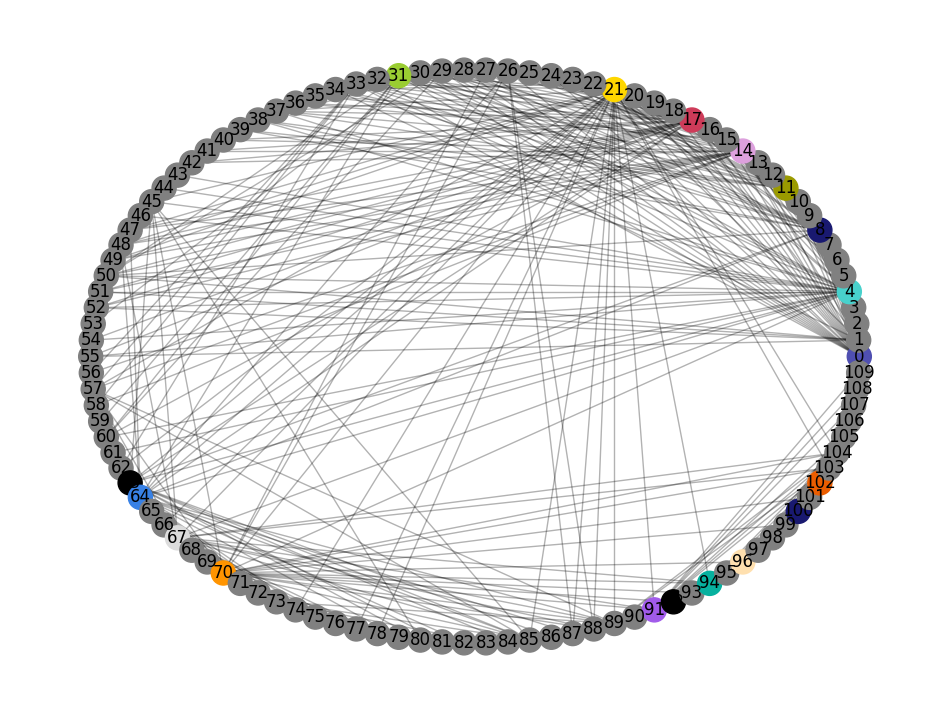

In [43]:
import matplotlib.pyplot as plt
%matplotlib inline
plt.rcParams["figure.figsize"] = [12, 9]

clrs = np.array([n[1]['colour'] for n in G.nodes.data()])
labels = {n[0]: n[1]['name'] for n in G.nodes.data()}

pos=nx.circular_layout(G)

nx.draw_networkx_nodes(G,
                       pos=pos,
                       node_color=clrs,
                       )

nx.draw_networkx_edges(G,
                       pos=pos,
                       alpha=0.3,
                       label={n[0]: n[1]['name'] for n in G.nodes.data()})

nx.draw_networkx_labels(G, pos=pos)
plt.axis('off')
plt.show()

<div class="alert alert-warning">

### **Degree Centrality – the more neighbors, the more important**
</div>

<div class="alert" style="background-color:  #E8F8F5; border-left: 8px solid #1ABC9C; padding: 14px; border-radius: 8px; font-size: 14px; color: #000000;">

This simplest form of centrality assumes that a node with many connections (relationships) occupies a central position within a local community.  
In other words, a node is considered central if it is connected to the largest number of other members in the group.  
Degree Centrality (DC) is calculated as the ratio of the number of connections a node has to the total number of other nodes in the graph.

</div>

In [44]:
degree_centrality = nx.degree_centrality(G)
degree_centrality_counts = Counter(degree_centrality)
for k, v in degree_centrality_counts.most_common(10):

    print(G.nodes[k]['name'], v)

ANAKIN 0.3761467889908257
OBI-WAN 0.3211009174311927
PADME 0.30275229357798167
C-3PO 0.30275229357798167
QUI-GON 0.23853211009174313
JAR JAR 0.22018348623853212
LUKE 0.22018348623853212
HAN 0.21100917431192662
EMPEROR 0.2018348623853211
LEIA 0.1926605504587156


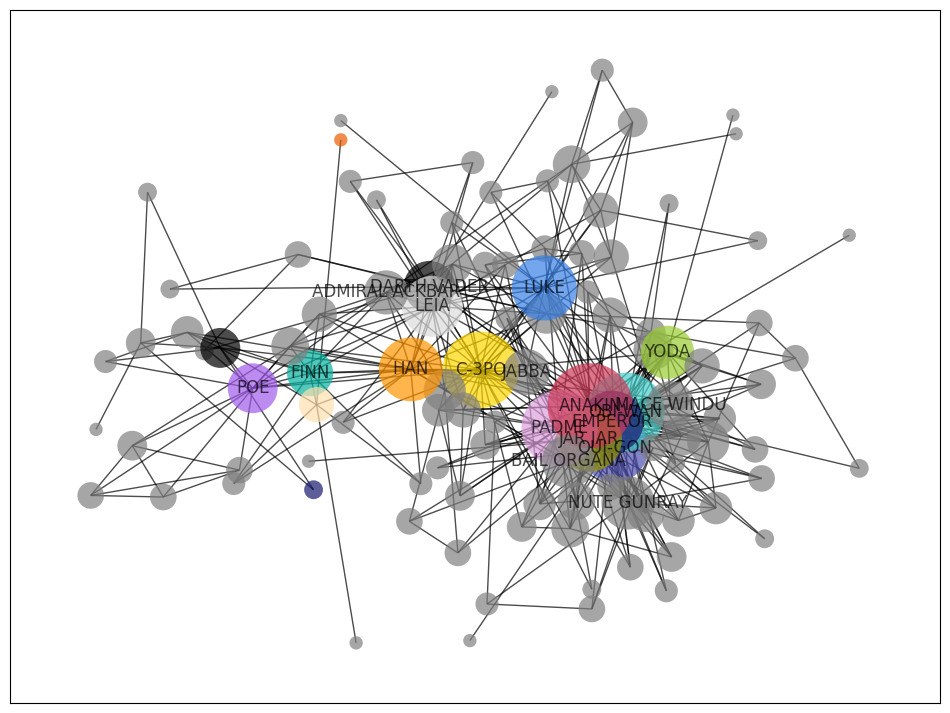

In [45]:
pos = nx.spring_layout(G, k=5*1/np.sqrt(len(G.nodes()))) # Fix randomness
th = degree_centrality_counts.most_common(20)[-1][1]
nx.draw_networkx(
    G,
    node_color=clrs,
    with_labels=True,
    alpha=0.7,
    labels={n[0]: n[1]['name'] for n in G.nodes.data() if degree_centrality[n[0]] > th},
    node_size=np.array(list(degree_centrality.values())) * 10000,
    linewidths=0.01,
    pos=pos,
)

<div class="alert alert-warning">

### **Betweenness Centrality**
</div>

<div class="alert" style="background-color:  #E8F8F5; border-left: 8px solid #1ABC9C; padding: 14px; border-radius: 8px; font-size: 14px; color: #000000;">

Betweenness centrality ranks nodes in a graph based on their importance in terms of the number of shortest paths that pass through them.

Imagine that between every pair of nodes in a graph, one particle travels along the shortest path(s). Each time a particle passes through a node, that node’s counter increases.  
The more frequently a node lies on shortest paths between others, the higher its centrality score — typically visualized by a larger node radius in the graph.

</div>


In [46]:
# Calculate betweenness centrality for all nodes
betweenness_centrality = nx.betweenness_centrality(G)
# Show top 10 nodes by betweenness centrality
top_betweenness = Counter(betweenness_centrality).most_common(10)

# Print the top 10 nodes and their betweenness centrality values
for k, v in top_betweenness:
    print(G.nodes[k]['name'], v)

OBI-WAN 0.21289741830262351
C-3PO 0.1926808487468285
HAN 0.1812153961936558
ANAKIN 0.1621708391273783
LUKE 0.137821617635291
DARTH VADER 0.0880518038555187
POE 0.08361809147724517
EMPEROR 0.07433337936695311
PADME 0.06946928856235446
KYLO REN 0.05646104121849159


<div class="alert alert-warning">

### **Closeness Centrality**
</div>

<div class="alert" style="background-color:  #E8F8F5; border-left: 8px solid #1ABC9C; padding: 14px; border-radius: 8px; font-size: 14px; color: #000000;">

Closeness centrality indicates how near a node is to all other nodes in the network.

Closeness centrality is a measure computed as the inverse of the sum of the shortest path lengths from a given node to all other nodes in the graph.  
The more central a node is, the shorter its total distance to all other nodes — meaning it is, on average, closer to the rest of the network.

</div>

In [47]:
closeness_centrality = nx.closeness_centrality(G)

closeness_centrality_counts = Counter(closeness_centrality)
for k, v in closeness_centrality_counts.most_common(10):
    print(G.nodes[k]['name'], v)

OBI-WAN 0.5515936820202403
C-3PO 0.5487649964714185
ANAKIN 0.5377345442810383
LUKE 0.5144671841919549
HAN 0.5047602561883331
EMPEROR 0.4908677720730579
PADME 0.48202330771138113
DARTH VADER 0.48202330771138113
LEIA 0.47986176821491755
QUI-GON 0.4693384838242395


<div class="alert" style="background-color: #FEF9E7; border-left: 8px solid #D4AC0D; padding: 14px; border-radius: 8px; font-size: 14px; color: #000000;">

To create a virtual environment with **Python 3.11** on macOS using Homebrew and `venv`, you just need to ensure Python 3.11 is installed and then explicitly use its path. Here's how:

---

#### Step-by-step Instructions

#### 1. **Install Python 3.11 using Homebrew** (if not already installed)

<div class="alert" style="background-color:rgb(0, 0, 0); border-left: 8px solid #B12111; padding: 14px; border-radius: 8px; font-size: 14px; color:rgb(255, 255, 255);">

```bash
brew install python@3.11
```
</div>

#### 2. **Find the path to Python 3.11**
<div class="alert" style="background-color:rgb(0, 0, 0); border-left: 8px solid #B12111; padding: 14px; border-radius: 8px; font-size: 14px; color:rgb(255, 255, 255);">

```bash
brew --prefix python@3.11
```
</div>

This will return something like:
<div class="alert" style="background-color:rgb(0, 0, 0); border-left: 8px solid #B12111; padding: 14px; border-radius: 8px; font-size: 14px; color:rgb(255, 255, 255);">

```
/opt/homebrew/opt/python@3.11
```
</div>

Python 3.11 will be located at:
<div class="alert" style="background-color:rgb(0, 0, 0); border-left: 8px solid #B12111; padding: 14px; border-radius: 8px; font-size: 14px; color:rgb(255, 255, 255);">

```
/opt/homebrew/opt/python@3.11/bin/python3.11
```
</div>

You can verify it with:
<div class="alert" style="background-color:rgb(0, 0, 0); border-left: 8px solid #B12111; padding: 14px; border-radius: 8px; font-size: 14px; color:rgb(255, 255, 255);">

```bash
/opt/homebrew/opt/python@3.11/bin/python3.11 --version
```
</div>

#### 3. **Create your virtual environment using that Python**

Navigate to your project folder and run:

<div class="alert" style="background-color:rgb(0, 0, 0); border-left: 8px solid #B12111; padding: 14px; border-radius: 8px; font-size: 14px; color:rgb(255, 255, 255);">

```bash
/opt/homebrew/opt/python@3.11/bin/python3.11 -m venv .venv
```
</div>

That will create a `.venv` directory using Python 3.11.

#### 4. **Activate the virtual environment**

<div class="alert" style="background-color:rgb(0, 0, 0); border-left: 8px solid #B12111; padding: 14px; border-radius: 8px; font-size: 14px; color:rgb(255, 255, 255);">

```bash
source .venv/bin/activate
```
</div>
You can verify the Python version inside the venv with:

<div class="alert" style="background-color:rgb(0, 0, 0); border-left: 8px solid #B12111; padding: 14px; border-radius: 8px; font-size: 14px; color:rgb(255, 255, 255);">

```bash
python --version
```

</div>
</div>

In [48]:
import karateclub

<div class="alert alert-danger">

will continue later
change python version from 3.12 to another one
AttributeError: module 'pkgutil' has no attribute 'ImpImporter'. Did you mean: 'zipimporter'?
[end of output]
</div>


We have figured out what a graph is and how to add features. Next, we are going to use this in ML?

There are two approaches: graph algorithms and graph neural networks. Here, we will look at the first approach, and the Swiss Army knife for graphs will help us: the `karateclub` library.

<center> <img src='https://karateclub.readthedocs.io/en/latest/_static/karate_logo_text.jpg' width='300' height='100' /> </center>

* Karateclub is a simple package with an sklearn-like API.
* It can be installed via conda or pip, but conda is preferred as pip may cause issues.